### Laboratorium 4 - zadania

In [13]:
import os

import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries, slic
from utils import *
np.random.seed(42)

#### Zadanie 1

Dane są obrazy `hare` i `pills`. Wykonaj dla nich segmentację przy użyciu algorytmu SLIC. Celem jest uzyskanie jednolitych  superpikseli, a więc zawierających tylko fragmenty obiektów lub tylko tła (a nie jednego i drugiego naraz). Przeanalizuj zachowanie algorytmu dla różnej liczby superpikseli i parametru sigma.

Zwróć uwagę, że wynikiem działania scikitowej implementacji SLIC - [`skimage.segmentation.slic`](https://scikit-image.org/docs/stable/api/skimage.segmentation.html#skimage.segmentation.slic) - (podobnie jak wielu innych algorytmów klasyfikacyjnych) jest obraz typu `np.int64` przyporządkowujący każdemu pikselowi obrazu wejściowego indeks superpiksela. Takiej reprezentacji oczekuje też funkcja [`mark_boundaries`](https://scikit-image.org/docs/stable/api/skimage.segmentation.html#skimage.segmentation.mark_boundaries).

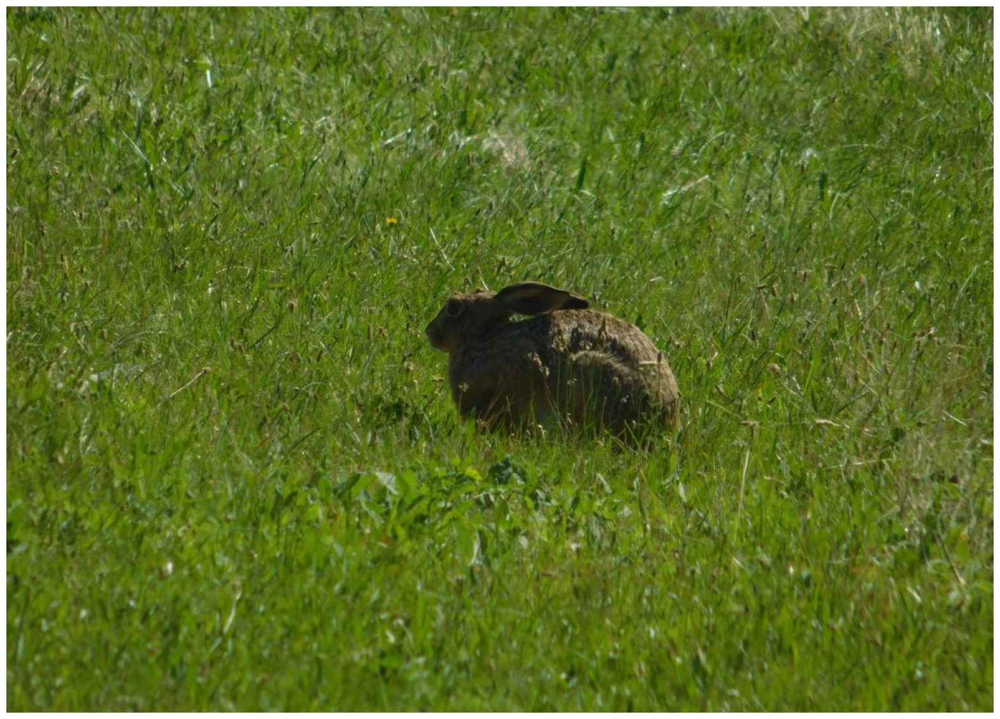

In [14]:
hare = cv2.imread('../dane/Zajac_kolor.jpg')[..., ::-1]
display_images([hare], ['original'])

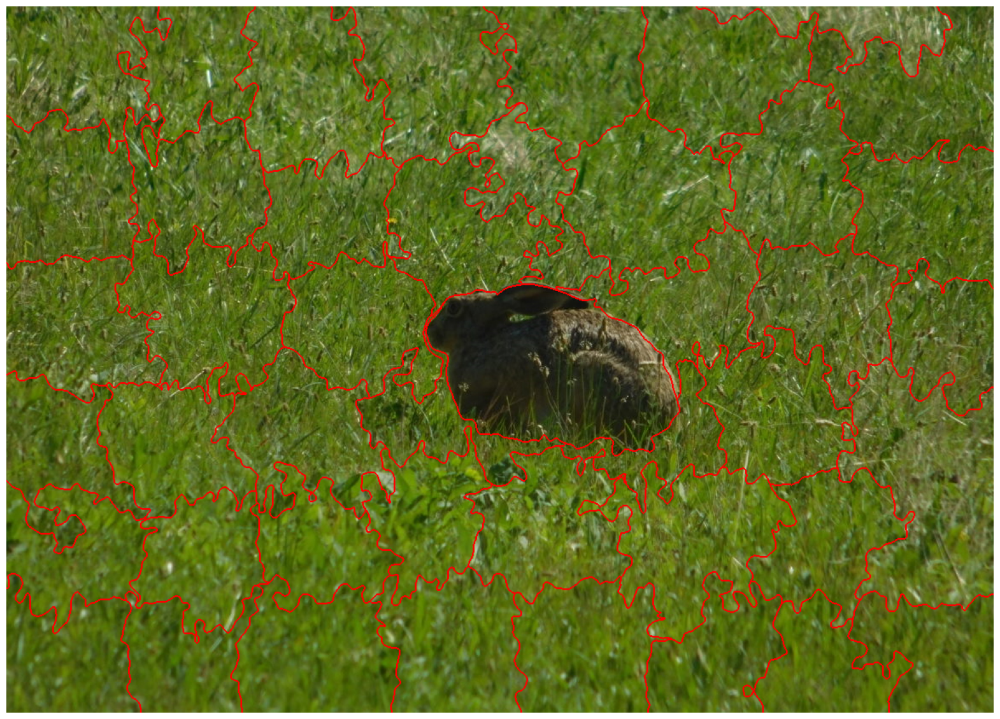

In [15]:
num_segments = 45
segments_hare = slic(hare, n_segments=num_segments, sigma=4)

boundaries_hare = mark_boundaries(hare, segments_hare, color=(1, 0, 0))

display_images([boundaries_hare], ['segmented'])

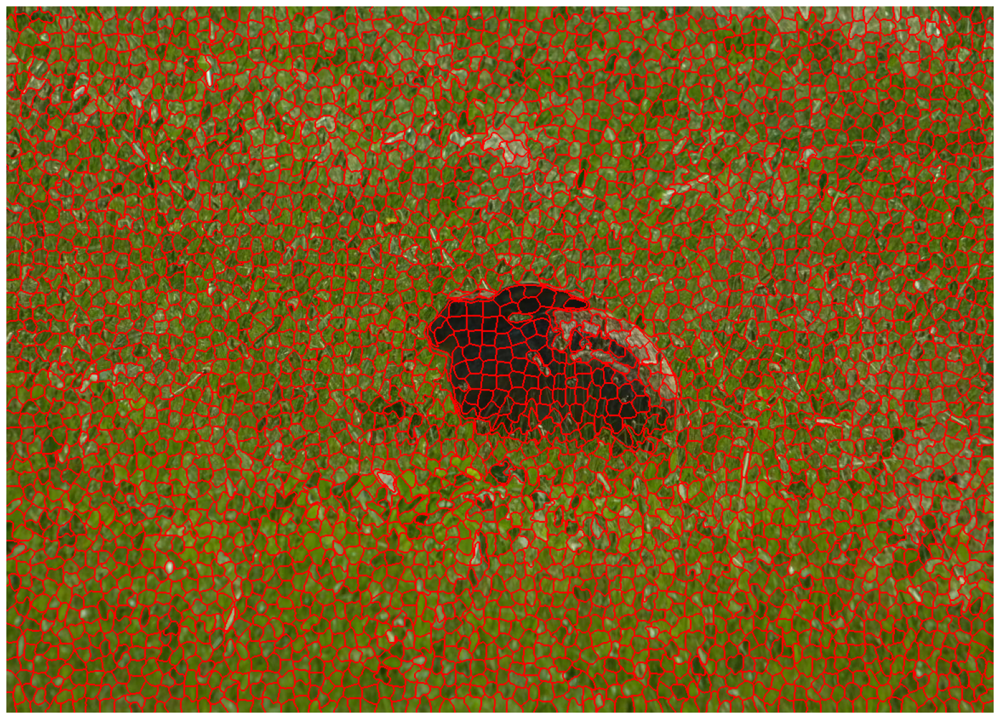

In [16]:
num_segments = 4000
segments_hare = slic(hare, n_segments=num_segments, sigma=2)

boundaries_hare = mark_boundaries(hare, segments_hare, color=(1, 0, 0))

display_images([boundaries_hare], ['segmented'])

sigma: 1


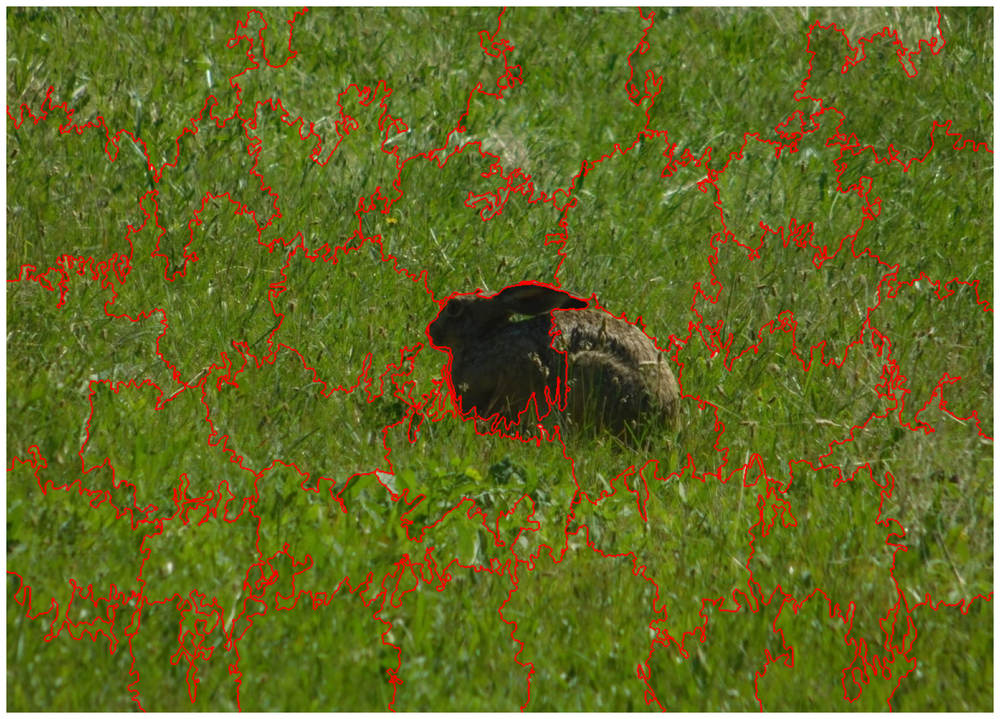

sigma: 8


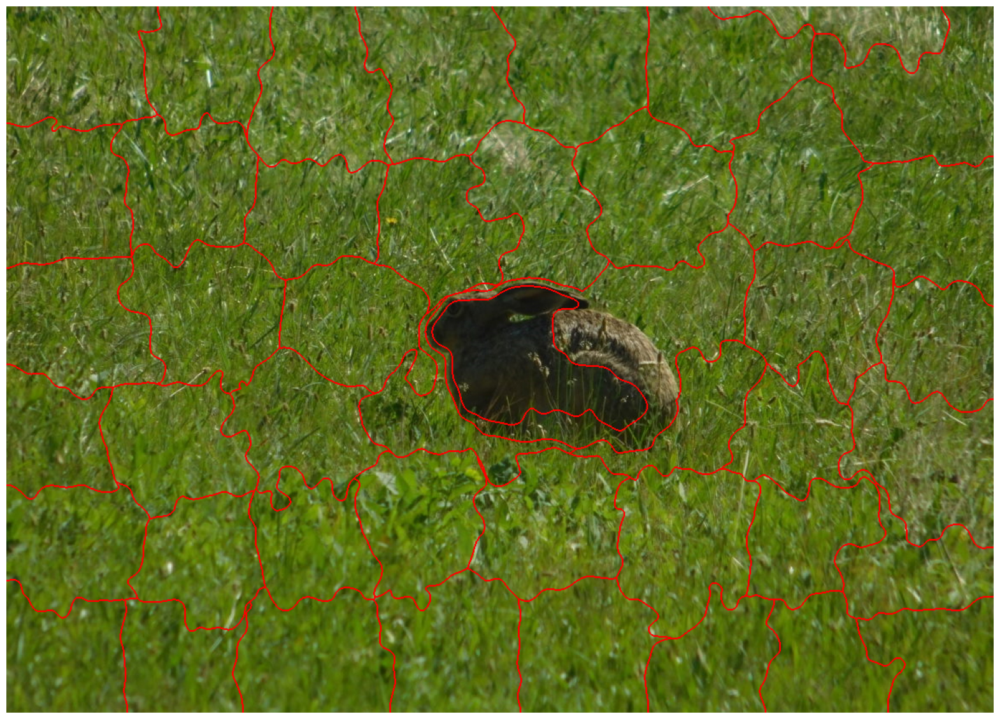

sigma: 75


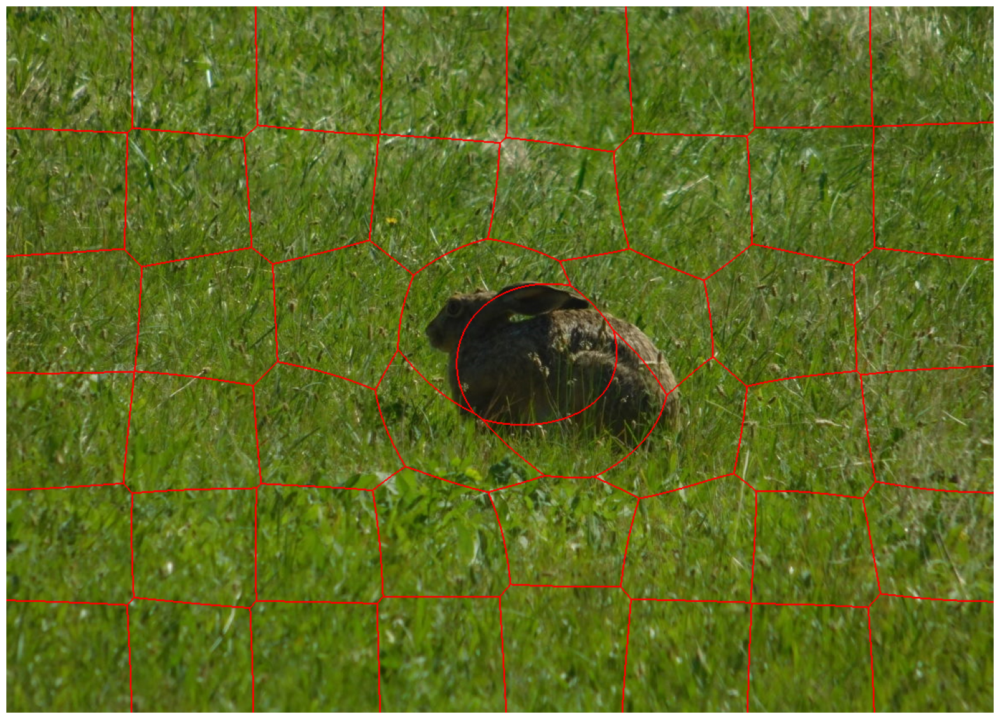

In [17]:
sigmas = [1, 8, 75]
num_segments = 45
for sigma in sigmas:
    segments_hare = slic(hare, n_segments=num_segments, sigma=sigma)
    boundaries_hare = mark_boundaries(hare, segments_hare, color=(1, 0, 0))
    print('sigma: {}'.format(sigma))
    display_images([boundaries_hare], ['segmented'])

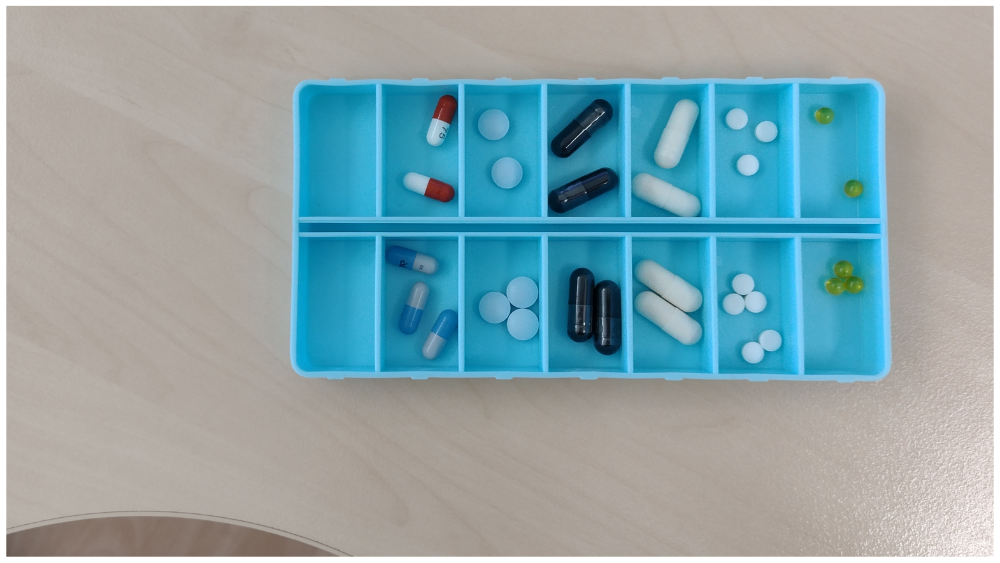

In [18]:
pills = cv2.imread('../dane/pills.png')[..., ::-1]
display_images([pills], ['original'])

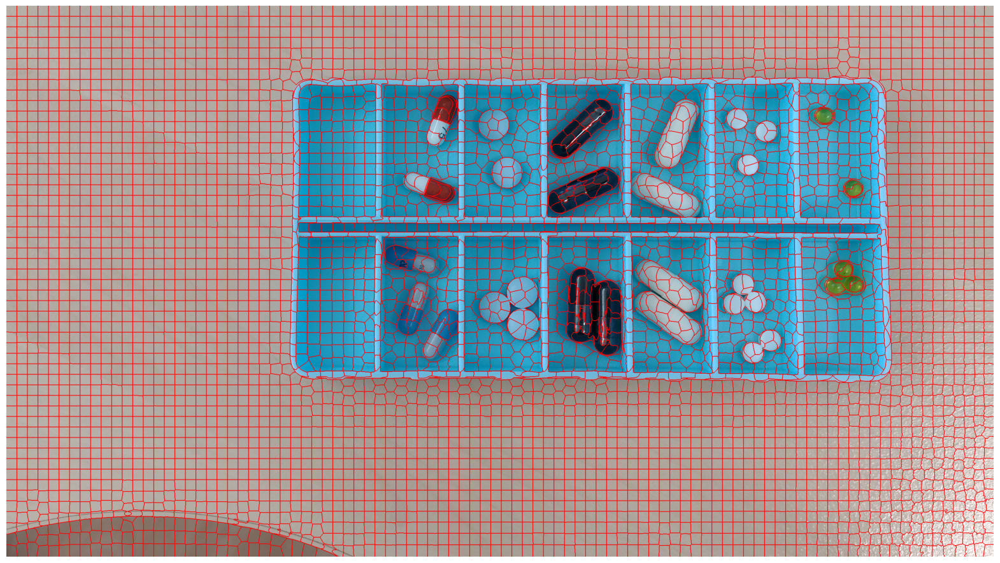

In [19]:
num_segments = 5000
segments_pills = slic(pills, n_segments=num_segments, sigma=2)

boundaries_pills = mark_boundaries(pills, segments_pills, color=(1, 0, 0))

display_images([boundaries_pills], ['segmented'])

#### Zadanie 2

Dla obrazu `hare` wykonaj post-processing segmentacji SLIC by uzyskać dwa jednorodne obszary: jeden zawierający wyłącznie zająca, drugi zawierający wyłącznie trawę. Wykorzystaj dowolny algorytm klasteryzacji (np. [`cv2.kmeans`](https://docs.opencv.org/4.x/d5/d38/group__core__cluster.html#ga9a34dc06c6ec9460e90860f15bcd2f88)) by pogrupować superpiksele w dwie klasy, używając *cech* superpikseli uzyskanych w zadaniu 1 jako danych wejściowych. Najprostszymi cechami, którymi można opisać superpiksele, są np. średnie wartości składowych barwy (pikseli, z których składa się superpiksel) - od nich zacznij. Wersja "na piątkę": zaproponuj swoją własną cechę i rozszerz o nią reprezentację superpiksela, a następnie powtórz grupowanie.

Zaprezentuj wyniki najlepiej za pomocą `mark_boundaries` albo po prostu wyświetlając maskę binarną.

---

NumPy pro-tip: aby uzyskać zbiór wszystkich pikseli obrazu o wartości np. 3 możesz użyć notacji: ```obraz==3```. Wynikiem jest macierz boolowska, której można używać jako selektor. Np. aby na obrazie `A` wyzerować wszystkie piksele, którym w obrazie `B` odpowiada wartość 5, możesz napisać: ```A[B==5] = 0```. Ten zapis jest **znacznie** szybszy niż manualne iterowanie po obrazach i sprawdzanie warunków if-ami.

Przykładowe użycie `cv2.kmeans` (więcej możesz poczytać np. [tutaj](https://opencv24-python-tutorials.readthedocs.io/en/latest/py_tutorials/py_ml/py_kmeans/py_kmeans_opencv/py_kmeans_opencv.html)):
```python
c, labels, centers = cv2.kmeans(
    data=data,  # np.ndarray typu float o wymiarach NxK gdzie N to liczba sampli (u nas: superpikseli), K - liczba cech
    K=2,        # oczekiwana liczba klastrów
    bestLabels=None,
    criteria=(cv2.TERM_CRITERIA_EPS, 10, 1.0),  # przykładowe kryteria stopu
    attempts=1, # liczba powtórzeń algorytmu
    flags=cv2.KMEANS_RANDOM_CENTERS  # sposób inicjalizacji klastrów
)
```

Funkcja ta zwraca krotkę, której najważniejszym komponentem jest ten drugi (tu: `labels`), tj. macierz o wymiarach Nx1, zawierająca indeks klastra przypisanego i-temu samplowi.

In [30]:
hare = cv2.imread('../dane/Zajac_kolor.jpg')[..., ::-1]
hare_hsv = cv2.cvtColor(hare, cv2.COLOR_RGB2HSV)

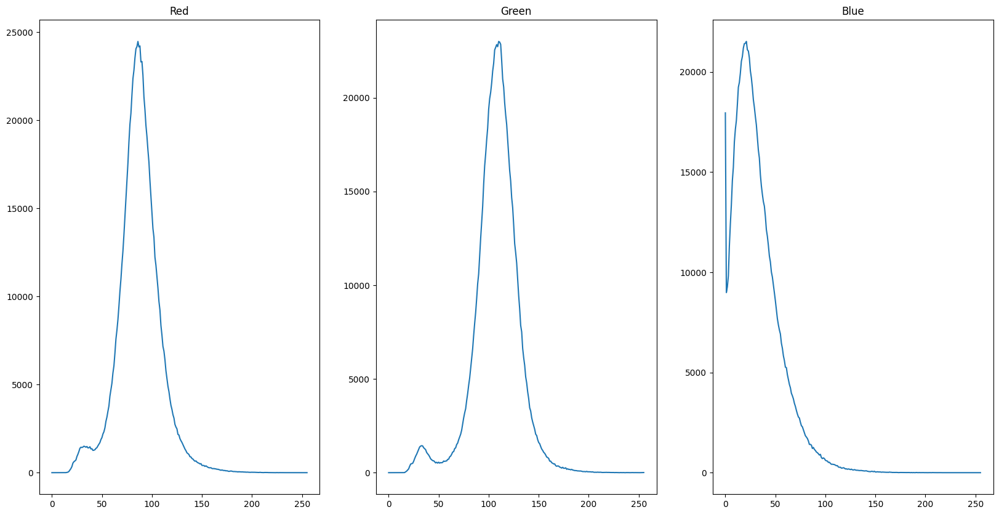

In [78]:
hist_rgb(hare)

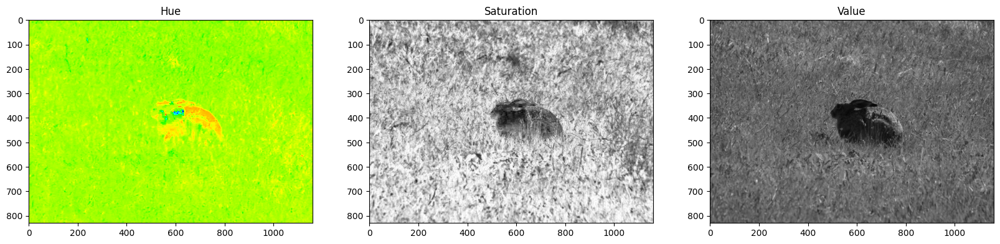

In [31]:
show_hsv(hare_hsv)

In [85]:
num_segments = 340
segments_hare = slic(hare, n_segments=num_segments, sigma=5)

unique_segments = np.unique(segments_hare)
unique_segments.shape

(348,)

In [86]:
features = np.zeros((len(unique_segments), 3))  # 3 to liczba składowych barwy (RGB)

# Uzyskaj cechy superpikseli (średnie wartości barw)
for i, segment_index in enumerate(unique_segments):
    mask = (segments_hare == segment_index)
    features[i] = np.mean(hare[mask], axis=0)

In [87]:
features.shape

(348, 3)

In [88]:
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 800, 0.01)
_, labels, centers = cv2.kmeans(features.astype(np.float32), 2, None, criteria, 50, cv2.KMEANS_PP_CENTERS)

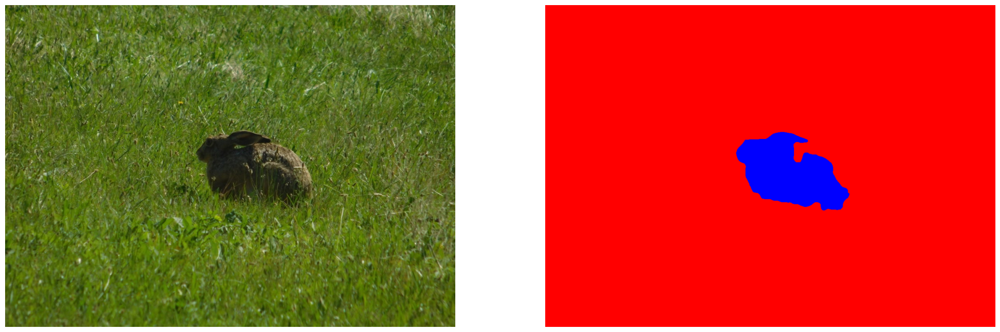

In [89]:
segment_labels = labels[np.searchsorted(unique_segments, segments_hare)] # Przypisz etykiety klastrów do superpikseli

mask_hare = (segment_labels == 0)
mask_grass = (segment_labels == 1)

hare_highlighted = hare.copy()
hare_highlighted[np.where(mask_grass)[0], np.where(mask_grass)[1], :] = [0, 0, 255]
hare_highlighted[np.where(mask_hare)[0], np.where(mask_hare)[1], :] = [255, 0, 0] 

display_images([hare, hare_highlighted],
               ['Original Image', 'Highlighted Regions (Hare in Blue, Grass in Red)'])

In [74]:
def calculate_area_perimeter_ratio(mask):
    # Oblicz stosunek obszaru do obwodu dla danego obszaru (maski)
    contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) > 0:
        area = cv2.contourArea(contours[0])
        perimeter = cv2.arcLength(contours[0], closed=True)
        return area / perimeter
    return 0.0

In [90]:
def calculate_gradient_features(image):
    # Przelicz gradienty dla składowej czerwonej i niebieskiej
    gradient_x_red = cv2.Sobel(image[:, :, 0], cv2.CV_64F, 1, 0, ksize=3)
    gradient_y_red = cv2.Sobel(image[:, :, 0], cv2.CV_64F, 0, 1, ksize=3)

    gradient_x_blue = cv2.Sobel(image[:, :, 2], cv2.CV_64F, 1, 0, ksize=3)
    gradient_y_blue = cv2.Sobel(image[:, :, 2], cv2.CV_64F, 0, 1, ksize=3)

    # Oblicz kąt gradientu
    angle_red = np.arctan2(gradient_y_red, gradient_x_red)
    angle_blue = np.arctan2(gradient_y_blue, gradient_x_blue)

    # Oblicz amplitudę gradientu
    magnitude_red = np.sqrt(gradient_x_red**2 + gradient_y_red**2)
    magnitude_blue = np.sqrt(gradient_x_blue**2 + gradient_y_blue**2)

    return angle_red, magnitude_red, angle_blue, magnitude_blue

In [91]:
# Inicjalizuj tablicę cech superpikseli (8 cech: średnie wartości barw + nasycenie + stosunek obszaru do obwodu + cechy gradientu)
features = np.zeros((len(unique_segments), 8))  # 3 dla średnich wartości barw, 1 dla nasycenia, 1 dla stosunku obszaru do obwodu, 2 dla cech gradientu

# Uzyskaj cechy superpikseli
for i, segment_index in enumerate(unique_segments):
    mask = (segments_hare == segment_index)
    segment_pixels = hare[mask]

    features[i, :3] = np.mean(segment_pixels, axis=0)
    features[i, 3] = np.mean(cv2.cvtColor(segment_pixels, cv2.COLOR_RGB2HSV)[:, :, 1])  # Nasycenie

    # Dodaj cechy gradientu
    angle_red, magnitude_red, angle_blue, magnitude_blue = calculate_gradient_features(segment_pixels)
    features[i, 4] = np.mean(angle_red)
    features[i, 5] = np.mean(magnitude_red)
    features[i, 6] = np.mean(angle_blue)
    features[i, 7] = np.mean(magnitude_blue)

# Klasteryzacja za pomocą cv2.kmeans
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2)
_, labels, centers = cv2.kmeans(features.astype(np.float32), 2, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

# Przypisz etykiety klastrów do superpikseli
segment_labels = labels[np.searchsorted(unique_segments, segments_hare)]

# Stwórz maski dla obszarów zawierających zająca i trawę

mask_hare = (segment_labels == 0)
mask_grass = (segment_labels == 1)

hare_highlighted = hare.copy()
hare_highlighted[np.where(mask_grass)[0], np.where(mask_grass)[1], :] = [0, 0, 255]
hare_highlighted[np.where(mask_hare)[0], np.where(mask_hare)[1], :] = [255, 0, 0]

display_images([hare, hare_highlighted],
               ['Original Image', 'Highlighted Regions (Hare in Blue, Grass in Red)'])

error: OpenCV(4.8.1) /Users/xperience/GHA-OpenCV-Python/_work/opencv-python/opencv-python/opencv/modules/imgproc/src/color.simd_helpers.hpp:92: error: (-2:Unspecified error) in function 'cv::impl::(anonymous namespace)::CvtHelper<cv::impl::(anonymous namespace)::Set<3, 4, -1>, cv::impl::(anonymous namespace)::Set<3, -1, -1>, cv::impl::(anonymous namespace)::Set<0, 5, -1>, cv::impl::(anonymous namespace)::NONE>::CvtHelper(cv::InputArray, cv::OutputArray, int) [VScn = cv::impl::(anonymous namespace)::Set<3, 4, -1>, VDcn = cv::impl::(anonymous namespace)::Set<3, -1, -1>, VDepth = cv::impl::(anonymous namespace)::Set<0, 5, -1>, sizePolicy = cv::impl::(anonymous namespace)::NONE]'
> Invalid number of channels in input image:
>     'VScn::contains(scn)'
> where
>     'scn' is 1


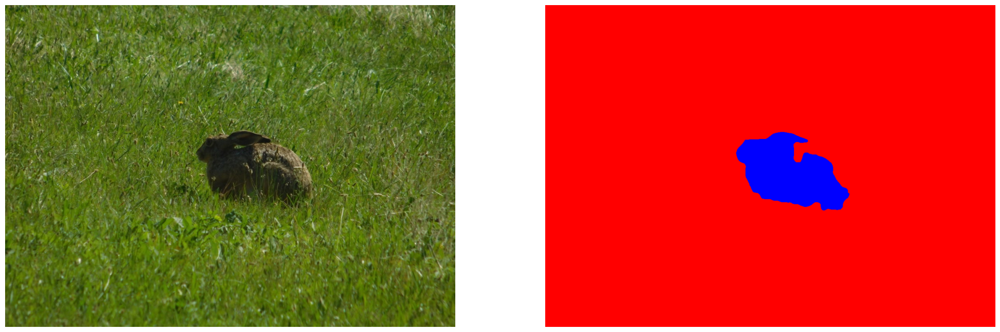

In [77]:
features = np.zeros((len(unique_segments), 4))  # 3 dla średnich wartości barw, 1 dla stosunku obszaru do obwodu

# Uzyskaj cechy superpikseli
for i, segment_index in enumerate(unique_segments):
    mask = (segments_hare == segment_index)
    features[i, :3] = np.mean(hare[mask], axis=0)
    features[i, 3] = calculate_area_perimeter_ratio(mask)

criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 800, 0.01)
_, labels, centers = cv2.kmeans(features.astype(np.float32), 2, None, criteria, 50, cv2.KMEANS_PP_CENTERS)

segment_labels = labels[np.searchsorted(unique_segments, segments_hare)]

mask_hare = (segment_labels == 0)
mask_grass = (segment_labels == 1)

hare_highlighted = hare.copy()
hare_highlighted[np.where(mask_grass)[0], np.where(mask_grass)[1], :] = [0, 0, 255]
hare_highlighted[np.where(mask_hare)[0], np.where(mask_hare)[1], :] = [255, 0, 0]

display_images([hare, hare_highlighted],
               ['Original Image', 'Highlighted Regions (Hare in Blue, Grass in Red)'])

Możesz wykorzystać poniższy snippet by zredukować wynik segmentacji SLIC (`segments`) w oparciu o klasteryzację k-średnich (`labels`):

In [79]:
# postprocessed = np.zeros_like(segments)
# for i in range(labels.shape[0]):
#     postprocessed[segments == i] = labels[i]  # jeśli używamy indeksowania od 0 w SLIC
#     postprocessed[segments == i + 1] = labels[i]  # jeśli używamy indeksowania od 1